# <center>AI FINAL PRESENTATION </center>

#### <center>15146327 Seung Kyu Hong</center>
#### <center>16102268 Yeoung Hyeon Kim</center>

# Abstract

Humans have mastered the skill to create unique visual experiences through composing a complex interplay between the content and style of image. Our project is to use deep learning techniques to convert a simple picture into a masterpiece. Here we conduct an artificial system based on a Deep Neural Network with the VGG-Network, a Convolutional Neural Network. Then, we combine paintings’ style and cover it to the content image. Our algorithms will be written in Google Colab, and the results will be quantitatively evaluated via student’s survey. The evaluation was conducted by students who are taking AI courses.

# Introduction

Due to the development of AI, more and more areas are where machines can work like humans. However, creative fields such as music and art are still considered human territory. It’s hard for machines to do original art on their own, but wouldn’t they be able to imitate the styles of masters like Gogh or Monet? Here we are going to change a simple picture into a Gogh painting. 

# In progress on a project

After progress our project, we realized that this project is widely introduced in AI study, even this course covered the projcet. Therefore we changed our goal to improve the given model and try to combine **three** images with two style images and a content image.

# Data Collection & Preprocessing



####Data Set




*   Gogh

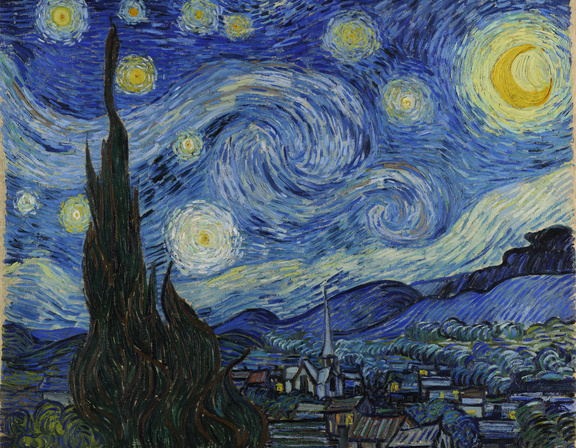


*   Picaso


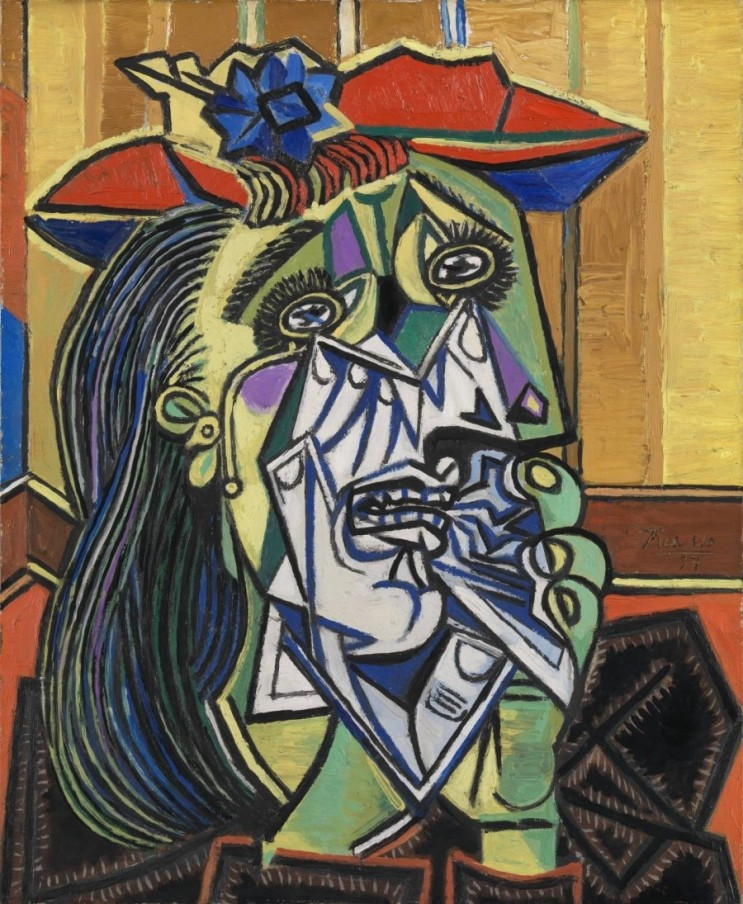









*   Mokpo


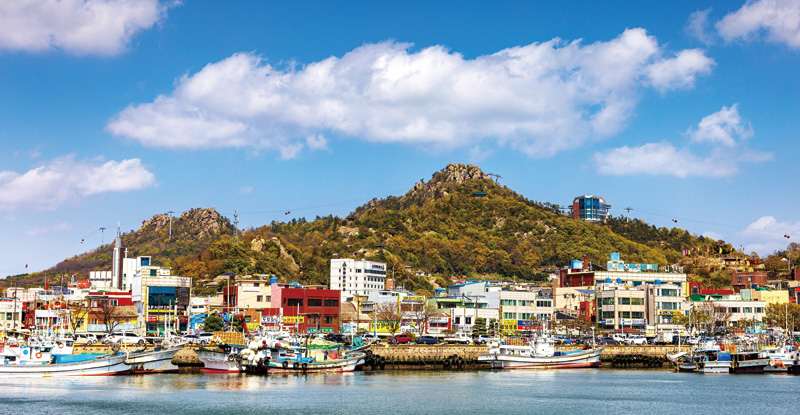










# Preprocessing

In [ ]:
import tensorflow as tf
import IPython.display as display



import matplotlib.pyplot as plt

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
MAX_DIM = 512
# This is the url to the image you want to transform.
content_path = '/content/gdrive/My Drive/image/mokpo.jpg'
# This is the url to the style image.
style_path = '/content/gdrive/My Drive/image/starry_night.jpg'
# This it the url to the style image2
style_path2 = '/content/gdrive/My Drive/image/picaso.jpg'


# Get an image and read it into a NumPy array.
def get_image(path_to_img, max_dim=MAX_DIM):
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]
    
    return img

# Normalize an image
def deprocess(img):
    img = 255*(img + 1.0)/2.0
    return tf.cast(img, tf.uint8)

# Display an image
def show(image, title=None):
    plt.clf()
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

# Transform a tensor to an image
def tensor_to_image(tensor):
    tensor = tensor*255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor)>3:
        assert tensor.shape[0] == 1
    tensor = tensor[0]   
    return PIL.Image.fromarray(tensor)

# Get images from image paths

In [ ]:
content_image = get_image(content_path)

In [ ]:
style_image = get_image(style_path)

In [ ]:
style_image2 = get_image(style_path2)

# Remind the previous model




*   VGG19

  *   VGG19 is a network created by the Visual Geometry Group (VGG) in Oxford, England. It is a pretained network that consisted of a total 16 convolution layers, 5 pooling layers, and 3 fully connected layers
  
   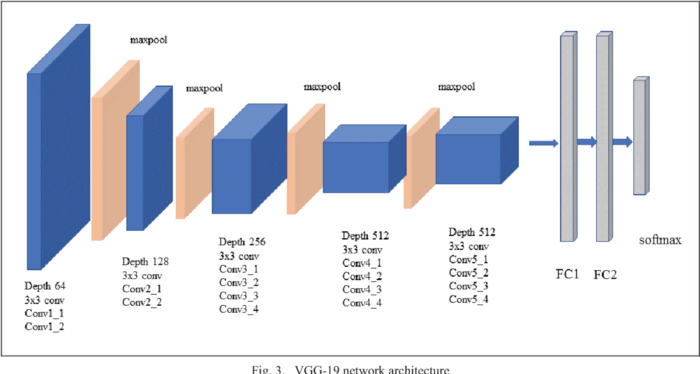



*   Gram Matrix

  *   Gram Matrix is a set of vectors in an inner product space is the Hermitian matrix of inner products, whose entries are given by 
  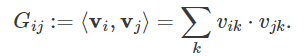

  *   In this project we will calculate the covariance between style layers, and the total covariance will be a style loss










*   Adam
  *   Adapt different size of updates to each parameter
  *   It is a combination of **Momentum** and **RMSProp**
  
  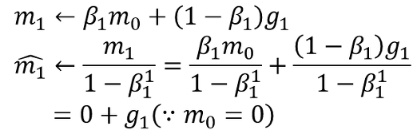










In [ ]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')


80142336/80134624 [==============================] - 1s 0us/step


In [ ]:
def vgg_model(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg_net = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg_net.trainable = False

    outputs = [vgg_net.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg_net.input], outputs)
    
    return model

In [ ]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    
    return result / (num_locations)

In [ ]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)


In [ ]:
opt = tf.optimizers.Adam(learning_rate=0.01, beta_1=0.99, epsilon=1e-1)

# First Model

**VGG Model and separate the convolution with 1 and 2**

At the very first time, we thought each style image should take different layers. Thus, we separate the block1 to block4 by convolution1 and convolution2

In [ ]:
style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1', 
    'block4_conv1'
]
style_layers2 = [
    'block1_conv2',
    'block2_conv2',
    'block3_conv2', 
    'block4_conv2'
]
content_layers = ['block5_conv2']

In [ ]:
style_extractor = vgg_model(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

In [ ]:
class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }

In [ ]:
extractor = StyleContentModel2(style_layers,style_layers2, content_layers)
results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print('Styles2:')
for name, output in sorted(results['style2'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())


Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.1314432
    max:  40082.598
    mean:  915.3312

   block2_conv2
    shape:  (1, 128, 128)
    min:  0.009157366
    max:  465209.8
    mean:  22886.543

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.18759374
    max:  506676.94
    mean:  23126.43

   block4_conv2
    shape:  (1, 512, 512)
    min:  0.0
    max:  5495888.5
    mean:  143406.64

Styles2:
   block1_conv2
    shape:  (1, 64, 64)
    min:  206.43582
    max:  952683.4
    mean:  18380.438

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  243823.17
    mean:  24277.537

   block3_conv2
    shape:  (1, 256, 256)
    min:  49.34364
    max:  576126.2
    mean:  38244.4

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  8909163.0
    mean:  320196.16

Contents:
   block5_conv2
    shape:  (1, 265, 512, 64)
    min:  0.0
    max:  2772.305
    mean:  129.45074


In [ ]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']
image = tf.Variable(content_image)

In [ ]:
style_weight = 1e-2
content_weight = 1e4

def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    style_loss = style_loss + style_loss2

    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    
    return loss

In [ ]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

Epoch: 1/10
....................................................................................................

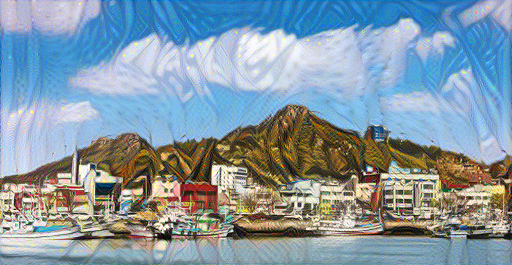

Epoch: 2/10
....................................................................................................

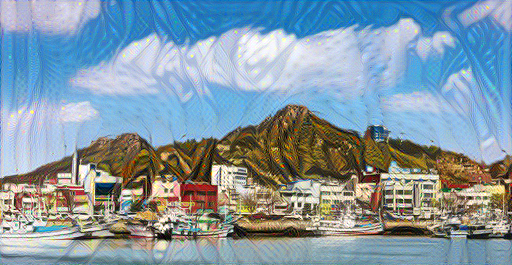

Epoch: 3/10
....................................................................................................

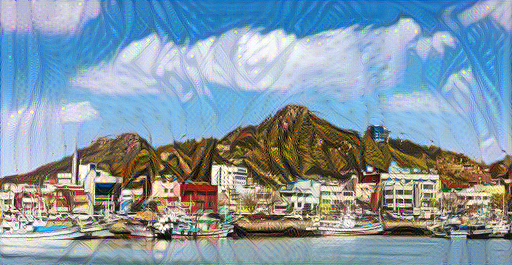

Epoch: 4/10
....................................................................................................

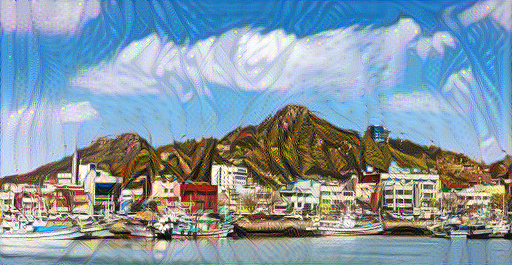

Epoch: 5/10
....................................................................................................

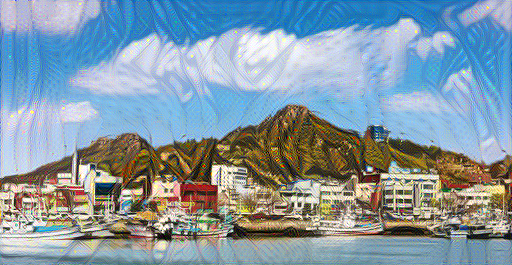

Epoch: 6/10
....................................................................................................

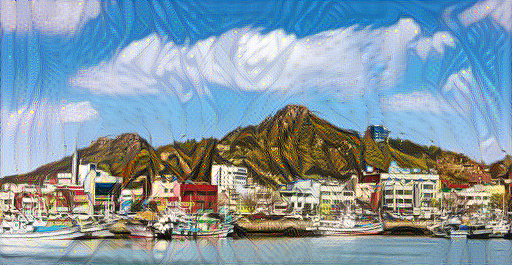

Epoch: 7/10
....................................................................................................

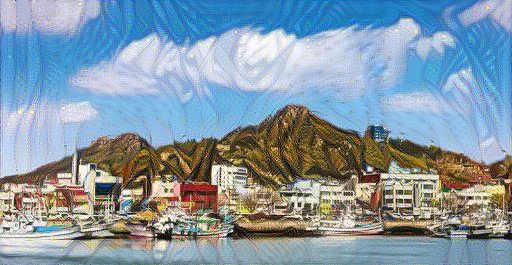

Epoch: 8/10
....................................................................................................

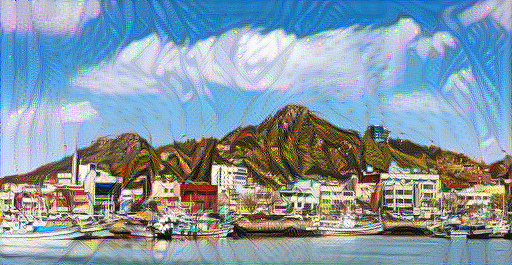

Epoch: 9/10
....................................................................................................

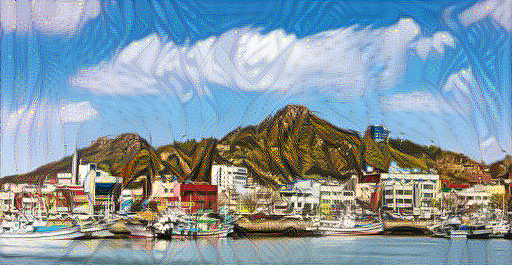

Epoch: 10/10
....................................................................................................

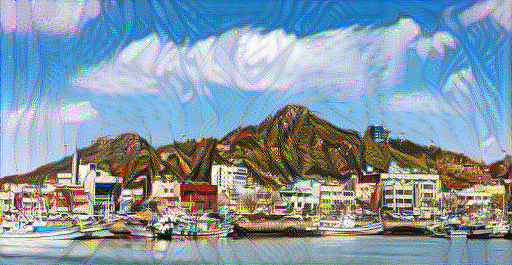

Total time: 3503.9


In [ ]:
import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
        train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Drawbacks

In general, the generated image shows Picaso. And the color of mountain is lumped together, we can see the small RGB pixels through our eyes.

---



# Second Model
**VGG Model and mixed convolution layer1 and 2**

According to the First model, we observed the effect of each block's convolution 2 on the image. Therefore, we mix the convolution layer 1 and 2 each block, without overlap

Epoch: 1/10
....................................................................................................

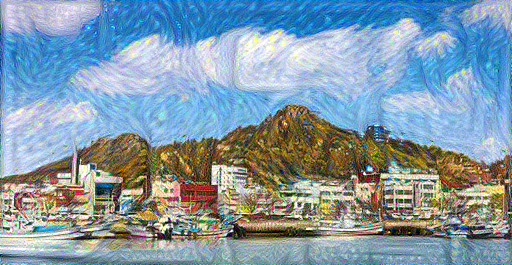

Epoch: 2/10
....................................................................................................

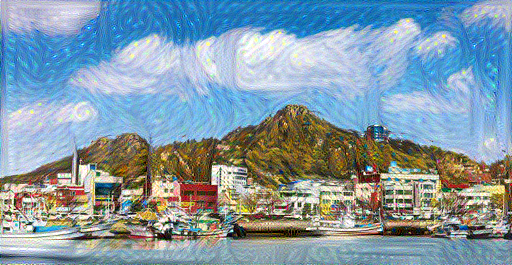

Epoch: 3/10
....................................................................................................

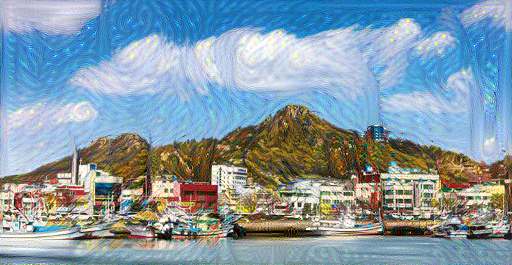

Epoch: 4/10
....................................................................................................

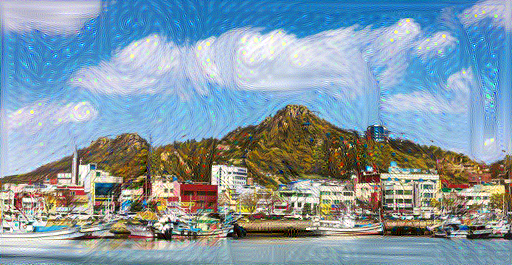

Epoch: 5/10
....................................................................................................

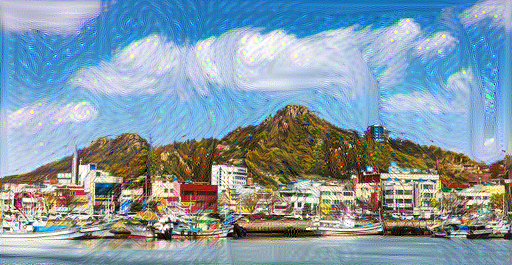

Epoch: 6/10
....................................................................................................

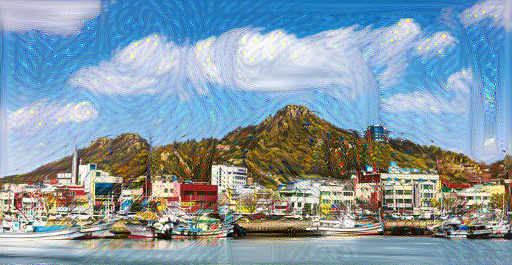

Epoch: 7/10
....................................................................................................

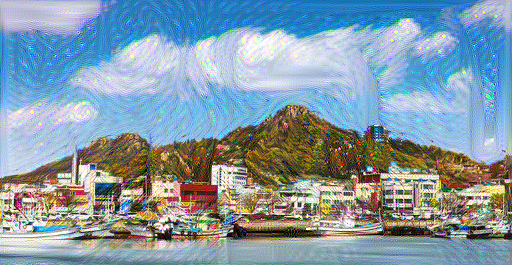

Epoch: 8/10
....................................................................................................

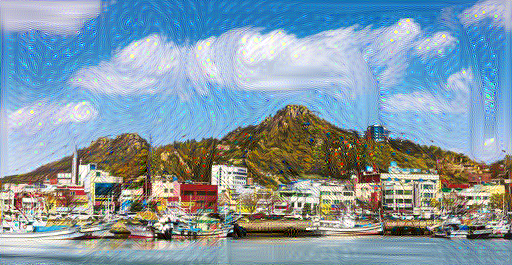

Epoch: 9/10
....................................................................................................

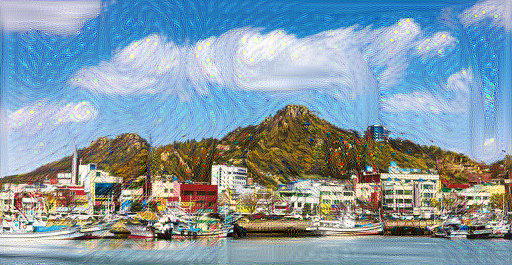

Epoch: 10/10
....................................................................................................

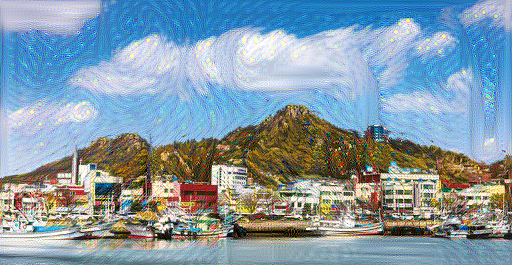

Total time: 1109.1


In [ ]:
style_layers = [
    'block1_conv1',
    'block2_conv2',
    'block3_conv1', 
    'block4_conv2'
]
style_layers2 = [
    'block1_conv2',
    'block2_conv1',
    'block3_conv2', 
    'block4_conv1'
]

style_extractor = vgg_model(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }


extractor = StyleContentModel2(style_layers, style_layers2, content_layers)
results = extractor(tf.constant(content_image))

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']
image = tf.Variable(content_image)

style_weight = 1e-2
content_weight = 1e4
def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    style_loss = style_loss + style_loss2

    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
    return loss

import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
      loss = train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Drawbacks

Compare to the First model, RGB pixels are observed much less. However it losts both style.

---



# Third Model
**VGG Model and separate the block of style layers**

According to the Second model, convolution layer 2 vanishes the actual style loss, that's why the original model used convolution layer 1 for style layers. From this factor, we separate the style layers by blocks without overlap.

Epoch: 1/10
....................................................................................................

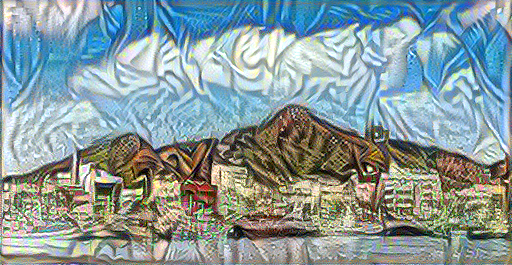

tf.Tensor(49470776.0, shape=(), dtype=float32)
Epoch: 2/10
....................................................................................................

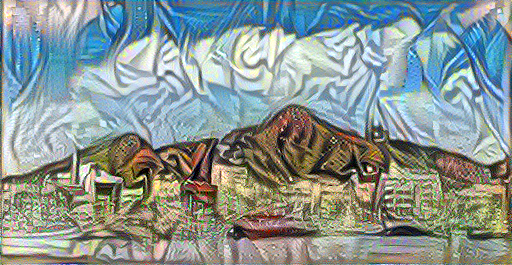

tf.Tensor(30307362.0, shape=(), dtype=float32)
Epoch: 3/10
....................................................................................................

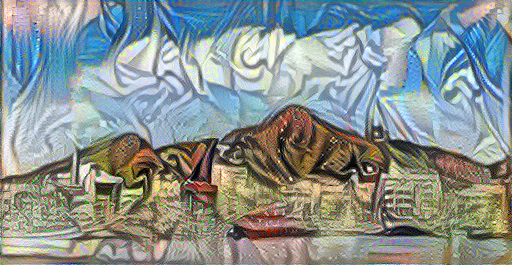

tf.Tensor(21917480.0, shape=(), dtype=float32)
Epoch: 4/10
....................................................................................................

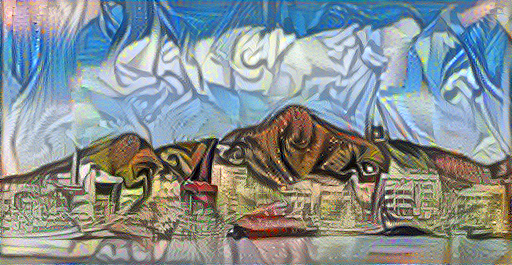

tf.Tensor(16963598.0, shape=(), dtype=float32)
Epoch: 5/10
....................................................................................................

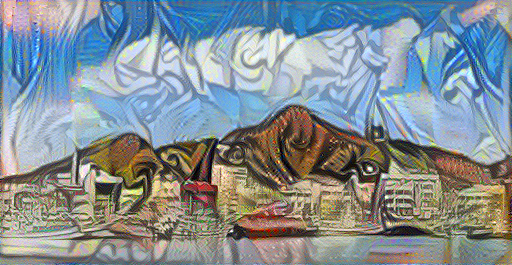

tf.Tensor(13852104.0, shape=(), dtype=float32)
Epoch: 6/10
....................................................................................................

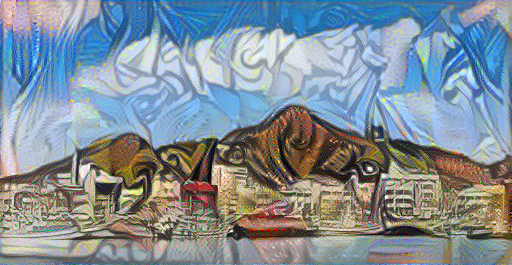

tf.Tensor(11968958.0, shape=(), dtype=float32)
Epoch: 7/10
....................................................................................................

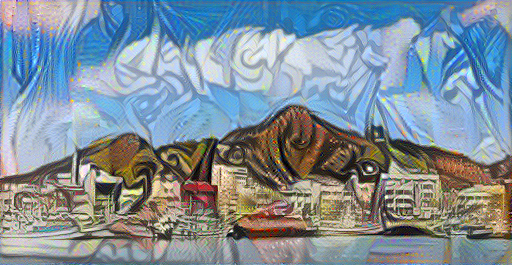

tf.Tensor(10842021.0, shape=(), dtype=float32)
Epoch: 8/10
....................................................................................................

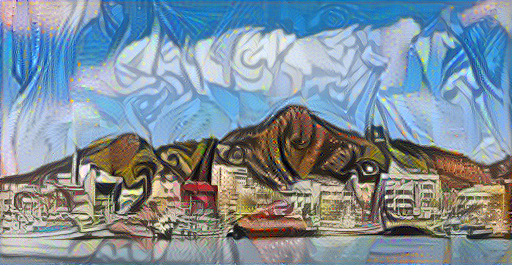

tf.Tensor(10148168.0, shape=(), dtype=float32)
Epoch: 9/10
....................................................................................................

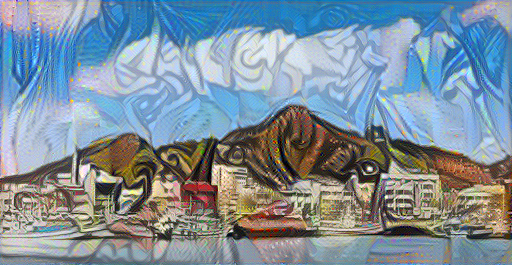

tf.Tensor(9699208.0, shape=(), dtype=float32)
Epoch: 10/10
....................................................................................................

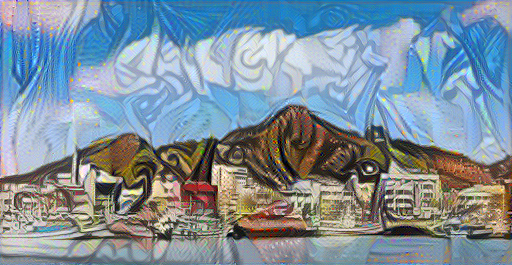

tf.Tensor(9390729.0, shape=(), dtype=float32)
Total time: 2785.2


In [ ]:
style_layers2 = [
    'block1_conv1',
     
    'block4_conv1'
]
style_layers = [
    'block2_conv1',
    
    'block3_conv1'
]

style_extractor = vgg_model(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }


extractor = StyleContentModel2(style_layers, style_layers2, content_layers)
results = extractor(tf.constant(content_image))

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']
image = tf.Variable(content_image)

style_weight = 1e-2
content_weight = 1e4
def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    
    
    style_loss = style_loss + style_loss2

    style_loss *= style_weight / num_style_layers

    

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
    return loss

import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
        loss = train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
    print(loss)  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Drawbacks

The result shows highly related with Picaso. We finally determined the style image which containing deeper layer has an effect to the style loss. 

---



# Fourth Model
**VGG Model and identical style layers + update style loss with adding style_weight2**

Through the previous model, we could construct identical style layers for both images. Then we focused on the stlye loss. So far, we adapted only one style weight for style loss. For comparison, we adapt same weight on style images, and divide it by it's number of layers.

Epoch: 1/10
....................................................................................................

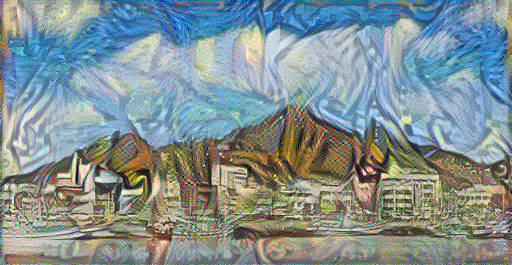

tf.Tensor(79988110.0, shape=(), dtype=float32)
Epoch: 2/10
....................................................................................................

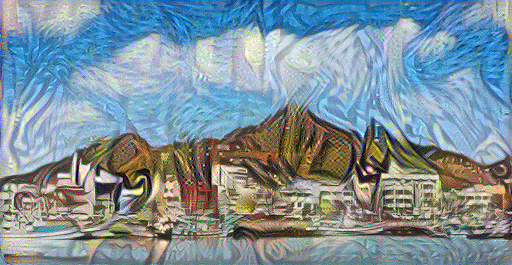

tf.Tensor(81039256.0, shape=(), dtype=float32)
Epoch: 3/10
....................................................................................................

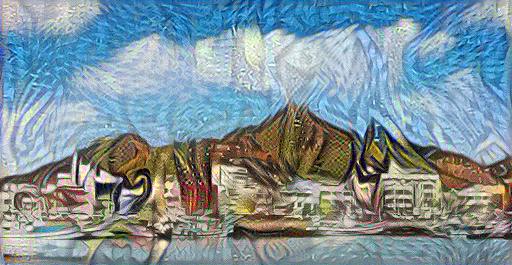

tf.Tensor(83832830.0, shape=(), dtype=float32)
Epoch: 4/10
....................................................................................................

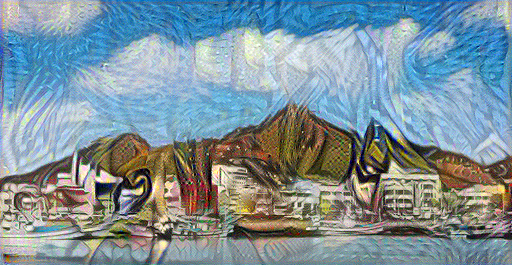

tf.Tensor(77042930.0, shape=(), dtype=float32)
Epoch: 5/10
....................................................................................................

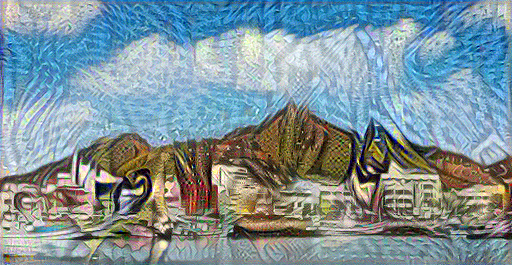

tf.Tensor(88432310.0, shape=(), dtype=float32)
Epoch: 6/10
....................................................................................................

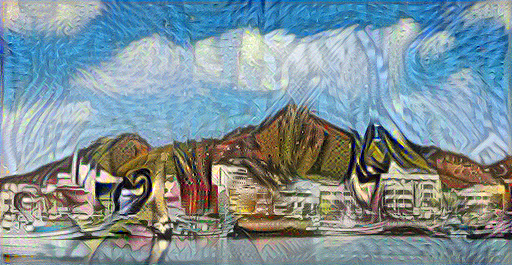

tf.Tensor(79784020.0, shape=(), dtype=float32)
Epoch: 7/10
....................................................................................................

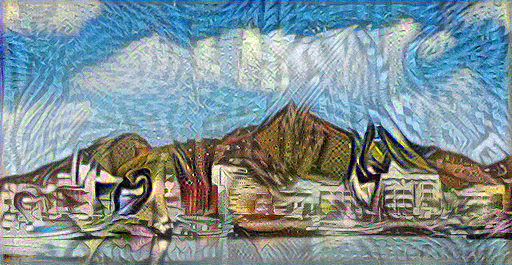

tf.Tensor(84605864.0, shape=(), dtype=float32)
Epoch: 8/10
....................................................................................................

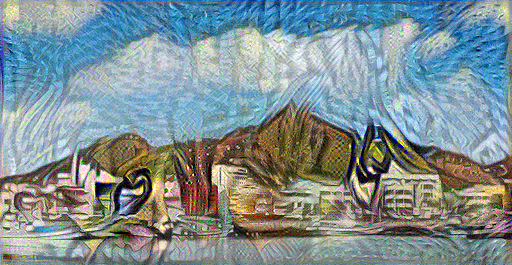

tf.Tensor(85181410.0, shape=(), dtype=float32)
Epoch: 9/10
....................................................................................................

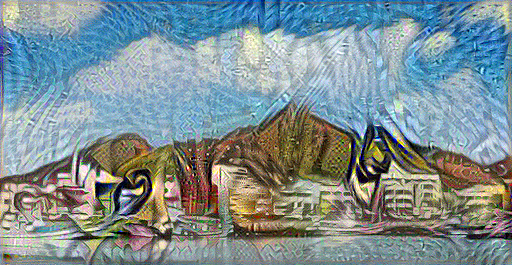

tf.Tensor(87201900.0, shape=(), dtype=float32)
Epoch: 10/10
....................................................................................................

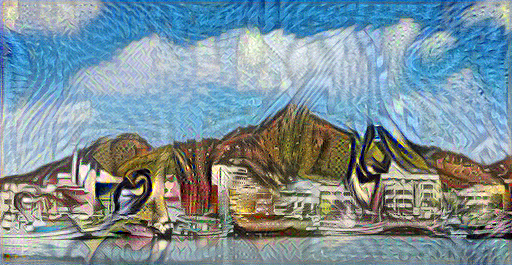

tf.Tensor(80935760.0, shape=(), dtype=float32)
Total time: 4428.9


In [ ]:
style_weight = 1e-2
style_weight2 = 1e-2
content_weight = 1e4
style_layers2 = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]
style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]

style_extractor = vgg_model(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }


extractor = StyleContentModel2(style_layers, style_layers2, content_layers)
results = extractor(tf.constant(content_image))

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']
image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.1, beta_1=0.9, epsilon=1e-1)
style_weight = 1e-2
content_weight = 1e4
def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    
    #style_loss = (style_loss * 0.5 + style_loss2 * 0.5) / (num_style_layers + num_style_layers2) * style_weight
    s1_loss = (style_loss * style_weight) / num_style_layers
    s2_loss = (style_loss2 * style_weight2) / num_style_layers2
    style = (s1_loss + s2_loss)

    #style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style + content_loss
    
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
    return loss

import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
        loss = train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
    print(loss)  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Drawbacks

The result shows quite good representation of Gogh and Picaso up to now. It definitly got Gogh and Picaso, but the cloud is a little unnatural. Also it keeps too much style of images, even the content vanished by it.

# Fifth Model
**Adding total variation loss**

Now we adapt some technique called total variation loss. Before learning the model we would refer some briefly about total variation loss.



*   Total variation loss
  *   One downside to this basic implementation is that it produces a lot of high frequency artifacts. Decrease these using an explicit regularization term on the high frequency components of the image. In style transfer, this is often called the total variation loss

  *   The regularization loss associated with this is the sum of the squares of the values

  *   Since Keras supports total variation loss for image tf.image.total_variation()












In [ ]:
total_variation_weight = 15
style_weight = 1e-2
style_weight2 = 1e-2
content_weight = 1e4
style_layers2 = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]
style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]

style_extractor = vgg_model(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }


extractor = StyleContentModel2(style_layers, style_layers2, content_layers)
results = extractor(tf.constant(content_image))

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']

In [ ]:
image = tf.Variable(content_image)

Epoch: 1/10
....................................................................................................

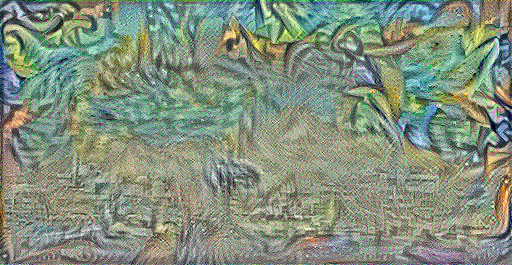

tf.Tensor([1.0249902e+08], shape=(1,), dtype=float32)
Epoch: 2/10
....................................................................................................

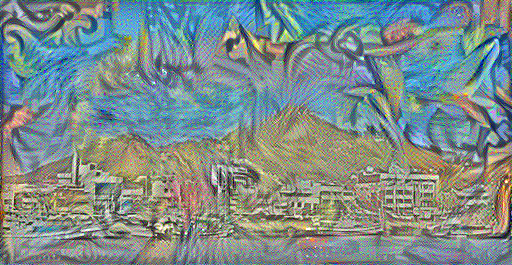

tf.Tensor([87706550.], shape=(1,), dtype=float32)
Epoch: 3/10
....................................................................................................

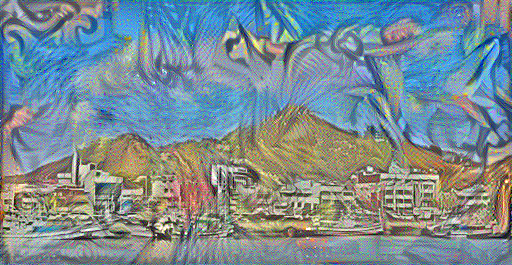

tf.Tensor([82019670.], shape=(1,), dtype=float32)
Epoch: 4/10
....................................................................................................

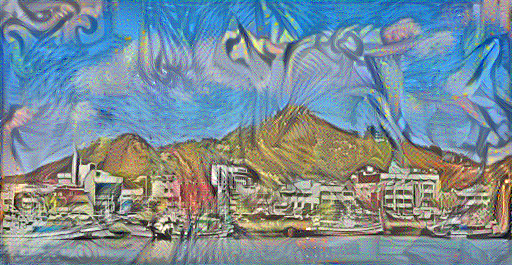

tf.Tensor([79096970.], shape=(1,), dtype=float32)
Epoch: 5/10
....................................................................................................

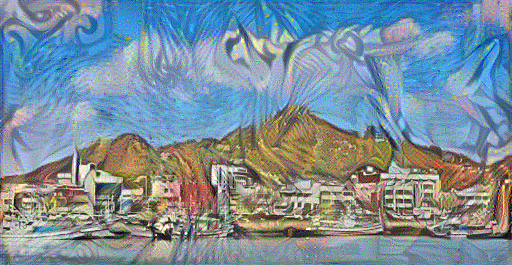

tf.Tensor([77245380.], shape=(1,), dtype=float32)
Epoch: 6/10
....................................................................................................

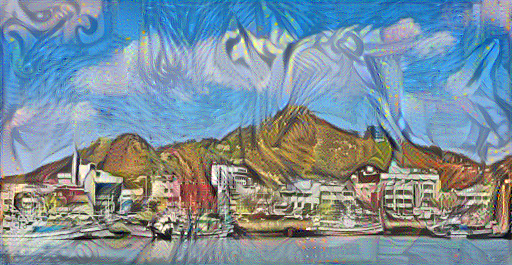

tf.Tensor([75961960.], shape=(1,), dtype=float32)
Epoch: 7/10
....................................................................................................

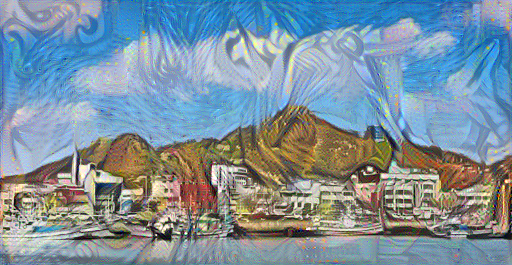

tf.Tensor([75062960.], shape=(1,), dtype=float32)
Epoch: 8/10
....................................................................................................

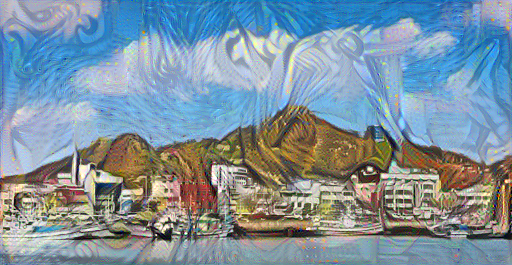

tf.Tensor([74431270.], shape=(1,), dtype=float32)
Epoch: 9/10
....................................................................................................

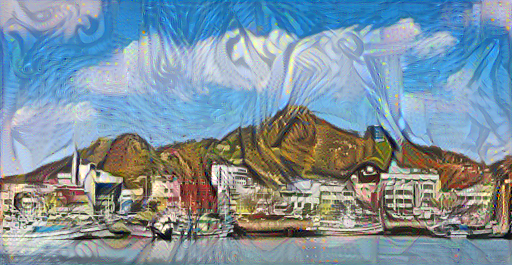

tf.Tensor([74001200.], shape=(1,), dtype=float32)
Epoch: 10/10
....................................................................................................

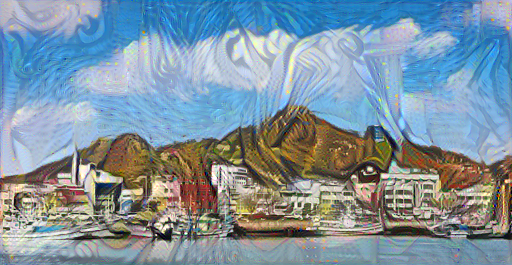

tf.Tensor([73710190.], shape=(1,), dtype=float32)
Total time: 4522.4


In [ ]:
def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    
    #style_loss = (style_loss * 0.5 + style_loss2 * 0.5) / (num_style_layers + num_style_layers2) * style_weight
    s1_loss = (style_loss * style_weight) / num_style_layers
    s2_loss = (style_loss2 * style_weight2) / num_style_layers2
    style = (s1_loss + s2_loss)

    #style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style + content_loss
    
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
        loss += total_variation_weight * tf.image.total_variation(image)
    grad = tape.gradient(loss, image)
    op.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
    return loss

import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
        loss = train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
    print(loss)  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Drawbacks

The result looks like the final image for our project. The content can see better than previous one. The cloud contains more Gogh, and the mountain contains more Picaso. Maybe it's because origin images represent each entity. Since we manipulate the hyperparameter of optimizer and style image features, we are going to handle the network by Layer Normalization.

---



# Final Model
**VGG Model with Layer Normalization**

It's time to manipulate network. We will add a Layer Normalization layer to our VGG19 model.



*   Layer Normalization
  *   Similar structure with Batch Normalization

  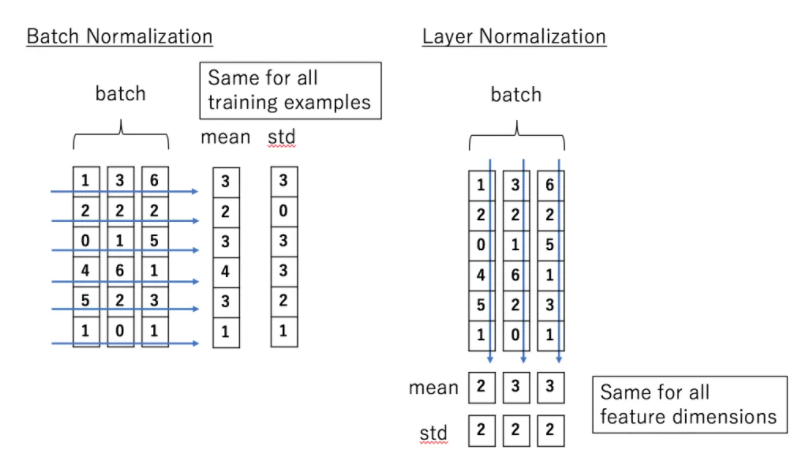
  * Difference between BN
    1. BN normalizes in Batch dimensions but LN normalizes in Feature dimensions
    2. LN computes in the hidden unit
    3. LN doesn't care about the size of batch, thus it shows great performance in RNN
  

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import models

model = models.Sequential()
model.add(vgg.input)
model.add(vgg.get_layer('block1_conv1'))
model.add(vgg.get_layer('block1_conv2'))
model.add(tf.keras.layers.LayerNormalization())
model.add(vgg.get_layer('block1_pool'))
model.add(vgg.get_layer('block2_conv1'))
model.add(vgg.get_layer('block2_conv2'))
model.add(tf.keras.layers.LayerNormalization())
model.add(vgg.get_layer('block2_pool'))
model.add(vgg.get_layer('block3_conv1'))
model.add(vgg.get_layer('block3_conv2'))
model.add(vgg.get_layer('block3_conv3'))
model.add(vgg.get_layer('block3_conv4'))
model.add(tf.keras.layers.LayerNormalization())
model.add(vgg.get_layer('block4_conv1'))
model.add(vgg.get_layer('block4_conv2'))
model.add(vgg.get_layer('block4_conv3'))
model.add(vgg.get_layer('block4_conv4'))
model.add(tf.keras.layers.LayerNormalization())
model.add(vgg.get_layer('block4_pool'))
model.add(vgg.get_layer('block5_conv1'))
model.add(vgg.get_layer('block5_conv2'))
model.add(vgg.get_layer('block5_conv3'))
model.add(vgg.get_layer('block5_conv4'))
model.add(tf.keras.layers.LayerNormalization())
model.add(vgg.get_layer('block5_pool'))

In [ ]:
def vgg_model_layernorm(layer_names):
    models = model
    models.trainable = False

    outputs = [models.get_layer(name).output for name in layer_names]
    m = tf.keras.Model([models.input],outputs)

    return m

Epoch: 1/10
....................................................................................................

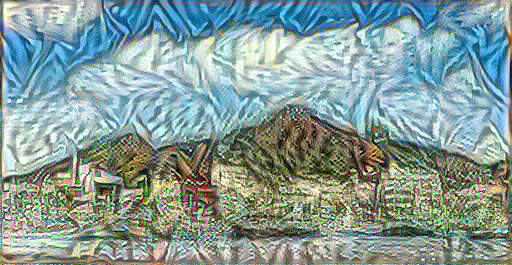

tf.Tensor([1.21998584e+08], shape=(1,), dtype=float32)
Epoch: 2/10
....................................................................................................

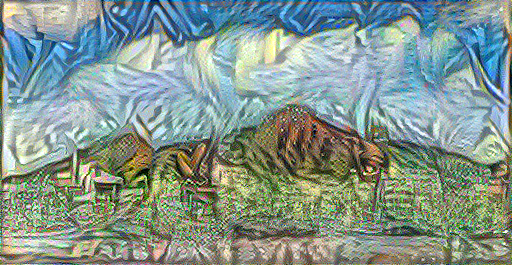

tf.Tensor([97832024.], shape=(1,), dtype=float32)
Epoch: 3/10
....................................................................................................

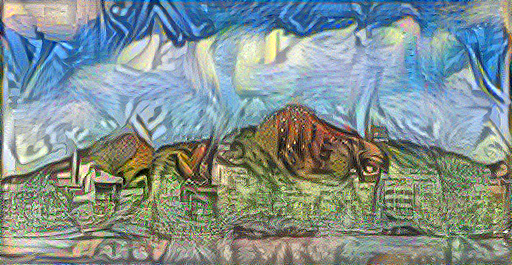

tf.Tensor([87708110.], shape=(1,), dtype=float32)
Epoch: 4/10
....................................................................................................

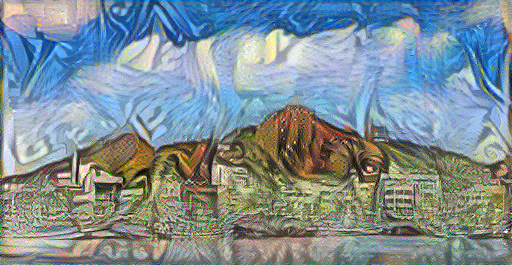

tf.Tensor([81709950.], shape=(1,), dtype=float32)
Epoch: 5/10
....................................................................................................

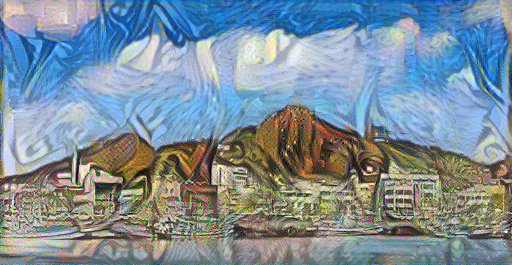

tf.Tensor([78154570.], shape=(1,), dtype=float32)
Epoch: 6/10
....................................................................................................

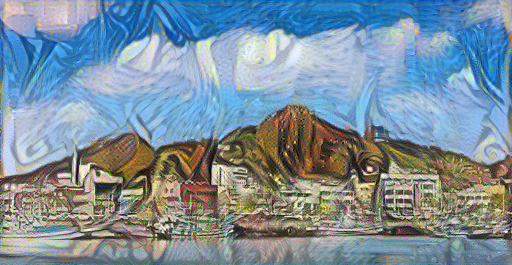

tf.Tensor([76121340.], shape=(1,), dtype=float32)
Epoch: 7/10
....................................................................................................

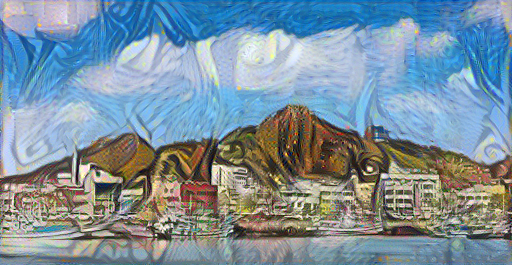

tf.Tensor([74934660.], shape=(1,), dtype=float32)
Epoch: 8/10
....................................................................................................

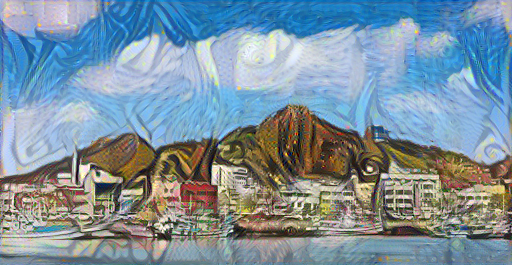

tf.Tensor([74210696.], shape=(1,), dtype=float32)
Epoch: 9/10
....................................................................................................

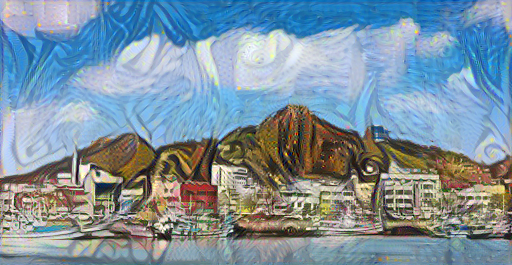

tf.Tensor([73759690.], shape=(1,), dtype=float32)
Epoch: 10/10
....................................................................................................

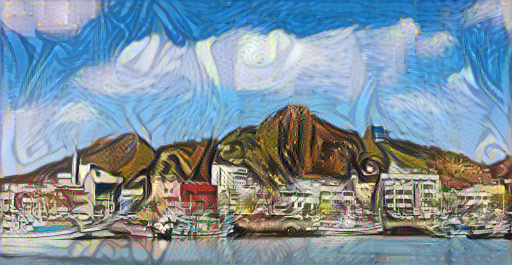

tf.Tensor([73470330.], shape=(1,), dtype=float32)
Total time: 4191.0


In [ ]:
total_variation_weight = 15
style_weight = 1e-2
style_weight2 = 1e-2
content_weight = 1e4
style_layers2 = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]
style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1',
    'block4_conv1',
    'block5_conv1'
]

style_extractor = vgg_model_layernorm(style_layers)
style_outputs = style_extractor(style_image * 255)

style_extractor2 = vgg_model_layernorm(style_layers2)
style_outputs2 = style_extractor2(style_image2 * 255)

class StyleContentModel2(tf.keras.models.Model):
    def __init__(self, style_layers,style_layers2,content_layers):
        super(StyleContentModel2, self).__init__()
        self.vgg =  vgg_model(style_layers + style_layers2 + content_layers)
        self.style_layers = style_layers
        self.style_layers2 = style_layers2
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.num_style_layers2 = len(style_layers2)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs,style_outputs2, content_outputs = (outputs[:self.num_style_layers],
                                                         outputs[self.num_style_layers:self.num_style_layers+self.num_style_layers2],
                                                         outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        style_outputs2 = [gram_matrix(style_output2)
                         for style_output2 in style_outputs2]

        content_dict = {content_name: value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}


        style_dict2 = {style_name: value
                      for style_name, value
                      in zip(self.style_layers2, style_outputs2)}

        return {'content': content_dict, 'style': style_dict, 'style2': style_dict2 }


extractor = StyleContentModel2(style_layers, style_layers2, content_layers)
results = extractor(tf.constant(content_image))

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
style_targets2 = extractor(style_image2)['style2']

image = tf.Variable(content_image)

def style_content_loss2(outputs):
    style_outputs = outputs['style']
    style_outputs2 = outputs['style2']

    content_outputs = outputs['content']

    num_style_layers = len(style_layers)
    num_style_layers2 = len(style_layers2)
    num_content_layers = len(content_layers)
    
    style_loss = tf.add_n(
        [tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
         for name in style_outputs.keys()]
    )
    style_loss2 = tf.add_n(
        [tf.reduce_mean((style_outputs2[name]-style_targets2[name])**2) 
         for name in style_outputs2.keys()]
    )
    
    #style_loss = (style_loss * 0.5 + style_loss2 * 0.5) / (num_style_layers + num_style_layers2) * style_weight
    s1_loss = (style_loss * style_weight) / num_style_layers
    s2_loss = (style_loss2 * style_weight2) / num_style_layers2
    style = (s1_loss + s2_loss)

    #style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n(
        [tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
         for name in content_outputs.keys()]
    )
    
    content_loss *= content_weight / num_content_layers
    loss = style + content_loss
    
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss2(outputs)
        loss += total_variation_weight * tf.image.total_variation(image)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
    return loss

import time

step = 3
start = time.time()

epochs = 10
steps_per_epoch = 100

for epoch in range(epochs):
    print(f"Epoch: {(epoch + 1)}/{epochs}".format(step))
    for step in range(steps_per_epoch):
        loss = train_step(image)
        print(".", end='')
    display.display(tensor_to_image(image))
    print(loss)  
end = time.time()

print("Total time: {:.1f}".format(end-start))

# Evaluation

# Conclusion

# Reference

[1] Leon A. Gatys, Alexander S. Ecker, Matthias Bethge. (2015). A Neural Algorithm of Artistic Style. Retrieved from https://arxiv.org/abs/1508.06576

[2] Karen Simonyan, Andrew Zisserman. (2015). Very Deep Convolutional Networks for Large-Scale Image Recognition. Retrieved from https://arxiv.org/abs/1409.1556

[3] Sebastian Ruder. (2017). An overview of gradient descent optimization algorithms. Retrieved from https://arxiv.org/abs/1609.04747

[4] Jimmy Lei Ba, Jamie Ryan Kiros, Geoffrey E. Hinton. (2016). Layer Normalization. Retrieved from https://arxiv.org/abs/1607.06450

[5] Yuying Li, F. Santosa. (1996). A computational algorithm for minimizing total variation in image restoration. Retrieved from https://ieeexplore.ieee.org/abstract/document/503914?casa_token=s5q67oLvVeIAAAAA:vYQk9q3Z8juer4YEmVNEO_sFzUDw12OZT6Ea4-YxLuLEYAxkuEVKEft0iDUl1UY1N8r3pURjLg


# Menber's contribution

Seung Kyu Hong: Model Learning, Make final material, Find improvement

Yeung Hyun Kim: Model Learning, Presentation, Find data, Find improvement

# Debugging experience worth sharing

When handling huge tensor data like image or video, it is the best to watch the whole state.

# Github 

https://github.com/SeungkyuHong2/AI_FINAL

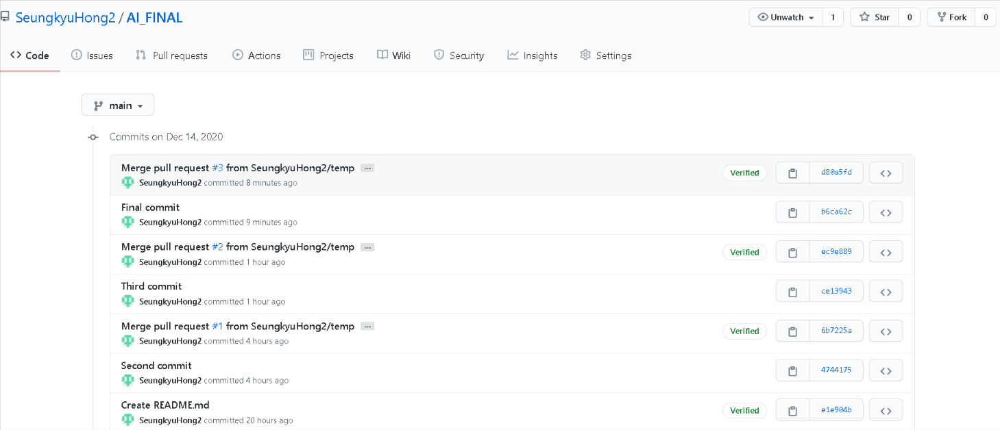